In [ ]:
!pip install supervision
!pip install numpy
!pip install roboflow
!pip install opencv-python
!pip install supervisely
!pip install inference

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 385.6/385.6 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.2/59.2 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 13.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.7/251.7 kB 21.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.7/239.7 kB 20.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 22.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.0/66.0 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.4/227.4 kB 22.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.7/65.7 kB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.9/5.9 MB 31.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 383.3/383.3 kB 31.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 148.1/148.1 kB 16.7 MB

In [ ]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


loading Roboflow workspace...
loading Roboflow project...
Detections(xyxy=array([[  0., 318.,  84., 382.]]), mask=None, confidence=array([0.40611291]), class_id=array([0]), tracker_id=None, data={'class_name': array(['QQ'], dtype='<U2')})


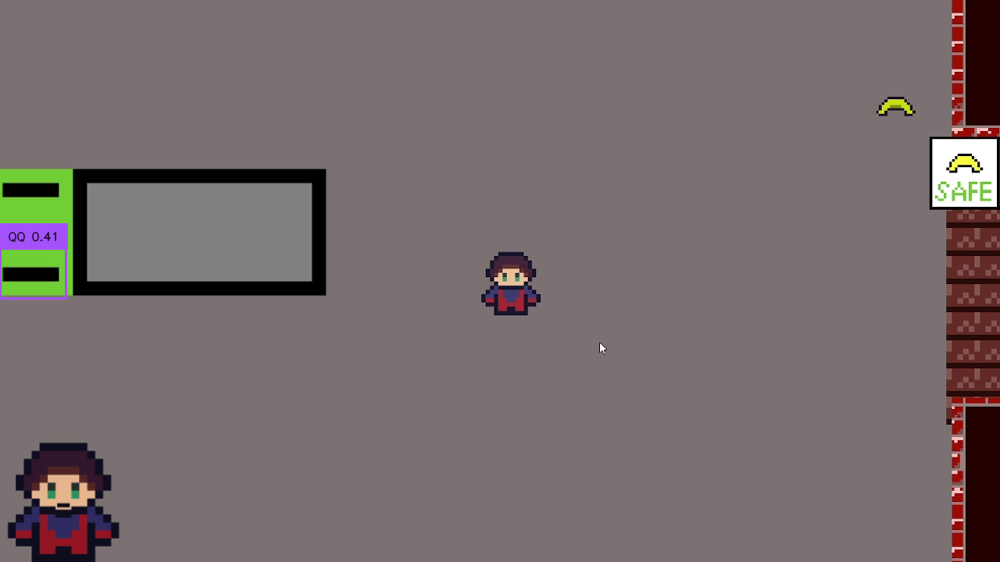

Detections(xyxy=array([], shape=(0, 4), dtype=float32), mask=None, confidence=array([], dtype=float32), class_id=array([], dtype=int64), tracker_id=None, data={})


KeyError: 'class_name'

In [ ]:
import supervision as sv
import numpy as np
import roboflow
import cv2
import time
from supervision import Detections
from google.colab.patches import cv2_imshow

INPUT_VIDEO = "/content/drive/MyDrive/12.01  Python/Roboflow/ГотовоеПК.mp4"

rf = roboflow.Roboflow(api_key="6PVuFYva42GrNxS7gFqx")

project = rf.workspace("igor-gxgi4").project("qq-miegb")

model = project.version(1).model


CLASSES_TO_CHECK = ["QQ"]

CLASS_IDX = {class_name: i for i, class_name in enumerate(CLASSES_TO_CHECK)}

CLASS_ID_TO_FILTER = [CLASS_IDX[class_name] for class_name in CLASSES_TO_CHECK]

detections_buffer = []

for i, frame in enumerate(sv.get_video_frames_generator(source_path=INPUT_VIDEO)):
    if len(detections_buffer) > 240:
        detections_buffer.pop(0)

    inference_results = model.predict(frame)

    detections = sv.Detections.from_inference(inference_results.json())
    print(detections)

    detections_filtered = [
        detection for detection, class_name in zip(detections, detections.data['class_name'])
        if class_name in CLASSES_TO_CHECK
    ]



    detections_buffer.append(detections)

    box_annotator = sv.BoxAnnotator()

    labels = [
        f"{CLASSES_TO_CHECK[detection[3]]} {detection[2]:0.2f}"
        for detection in detections
    ]

    annotated_frame = box_annotator.annotate(
        scene=frame.copy(),
        detections=detections,
        labels=labels
    )

    cv2_imshow(annotated_frame)
    time.sleep(1)

loading Roboflow workspace...
loading Roboflow project...


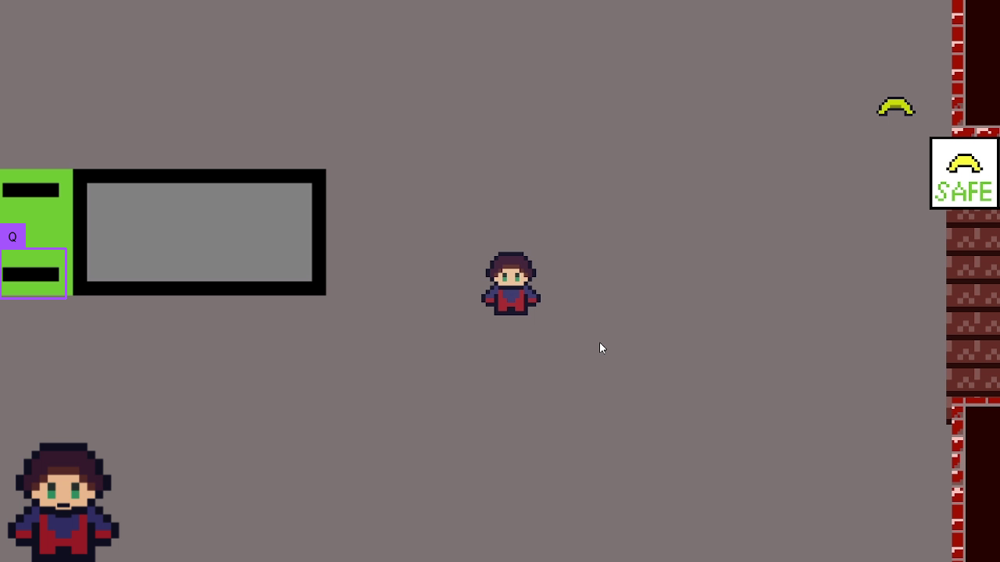

Ключ 'class_name' отсутствует в detections.data


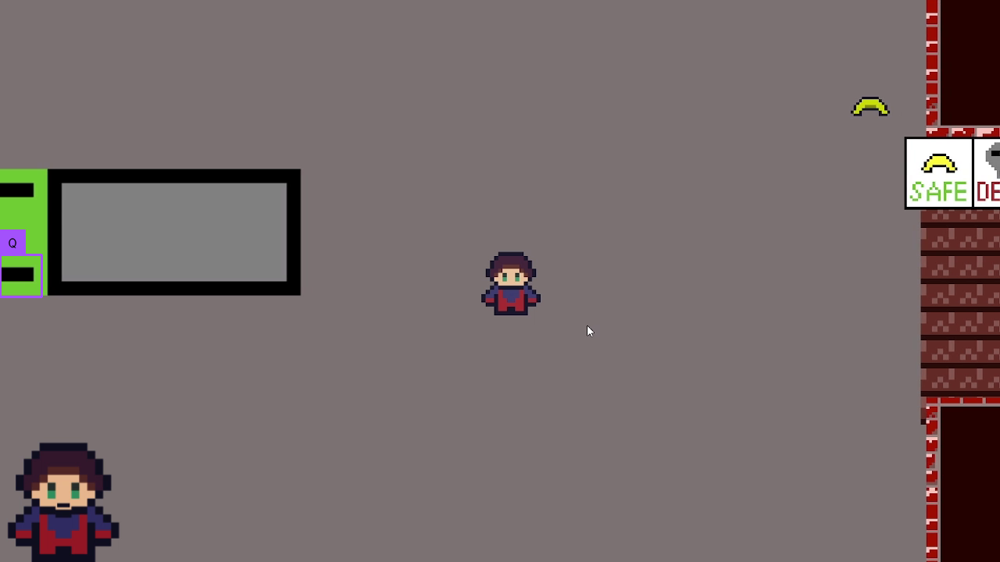

Ключ 'class_name' отсутствует в detections.data


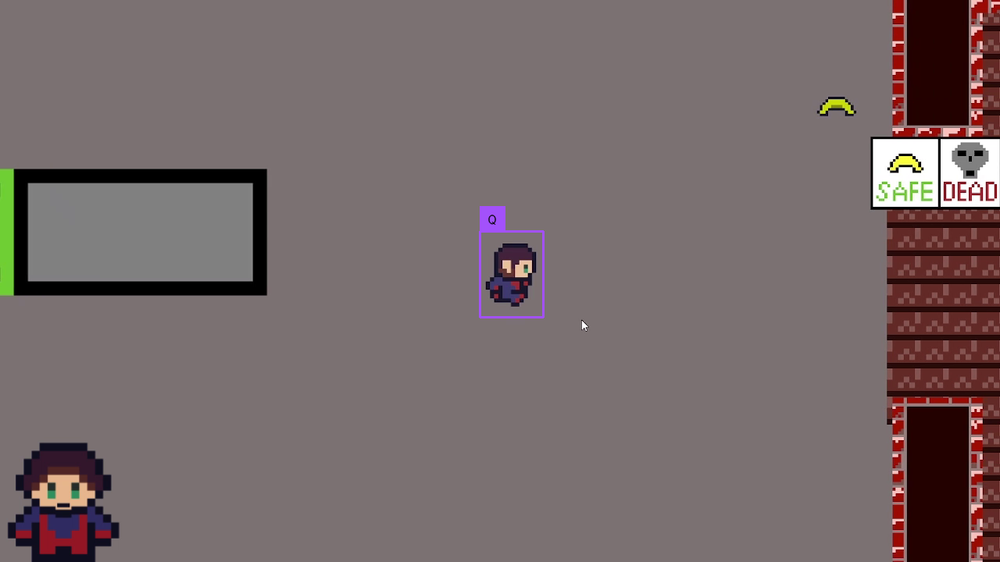

Ключ 'class_name' отсутствует в detections.data


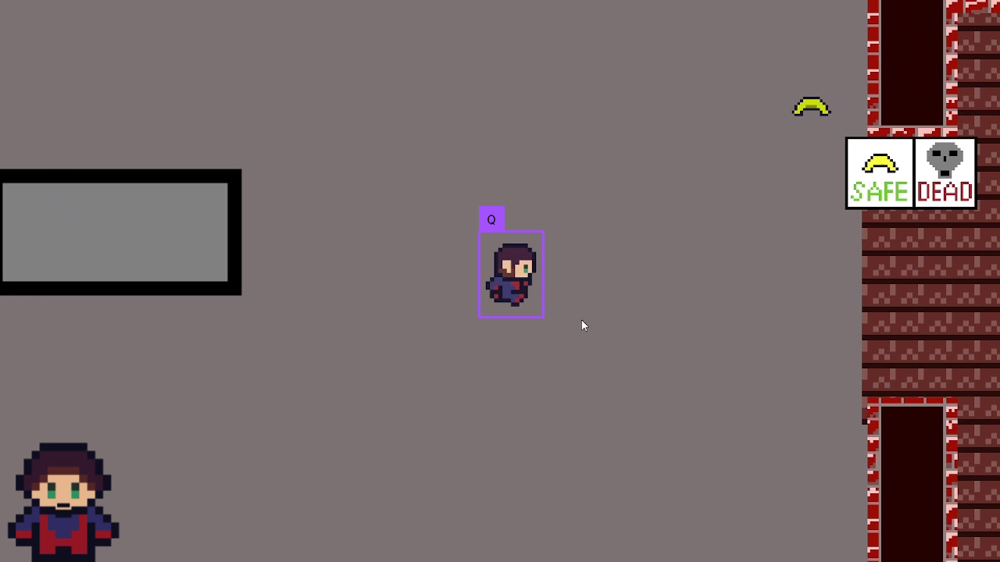

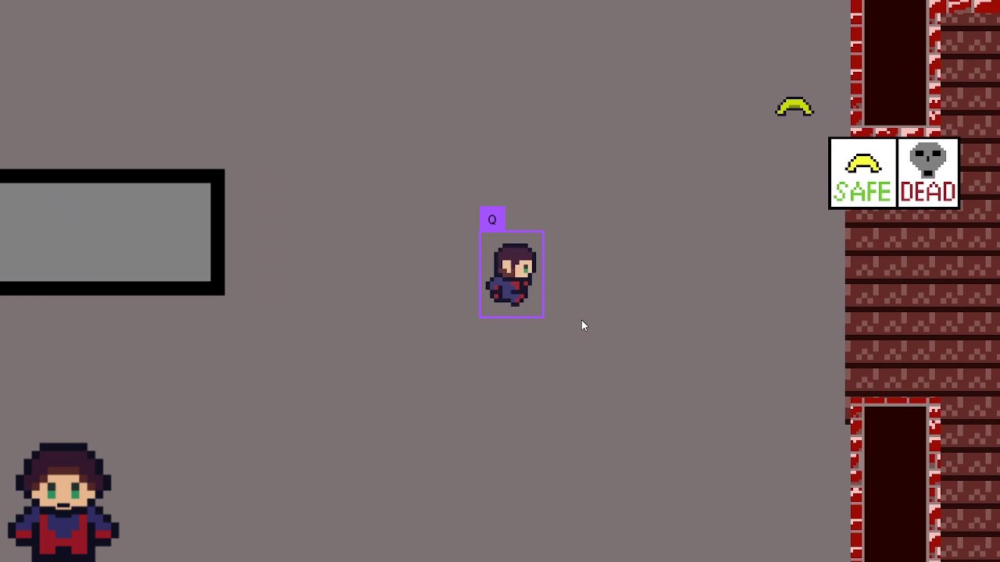

Ключ 'class_name' отсутствует в detections.data
Ключ 'class_name' отсутствует в detections.data
Ключ 'class_name' отсутствует в detections.data
Ключ 'class_name' отсутствует в detections.data


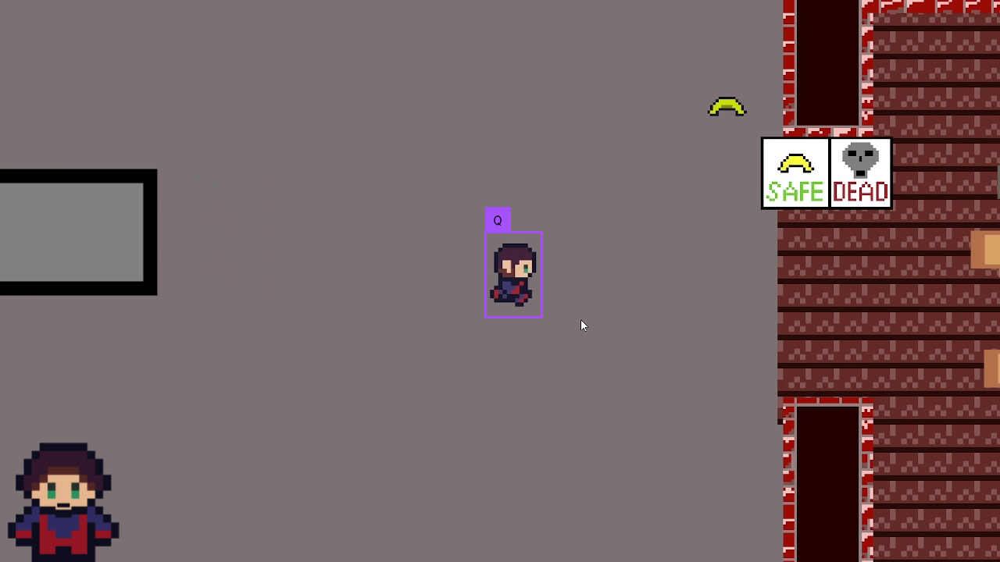

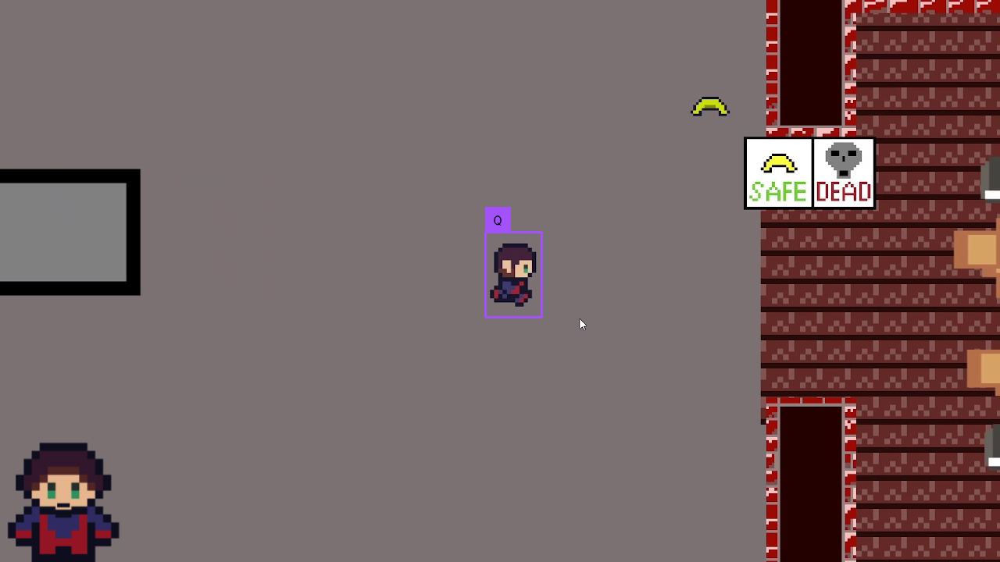

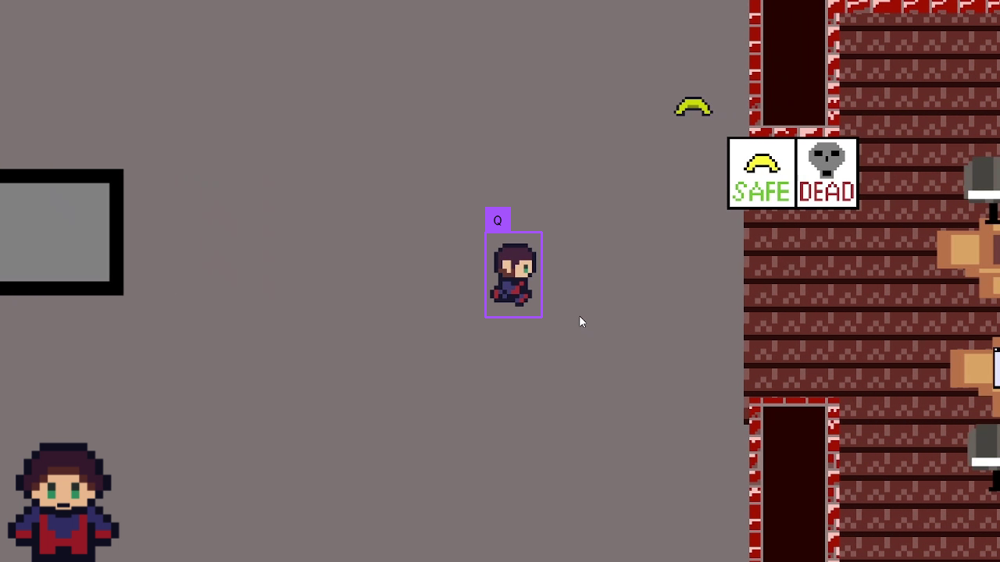

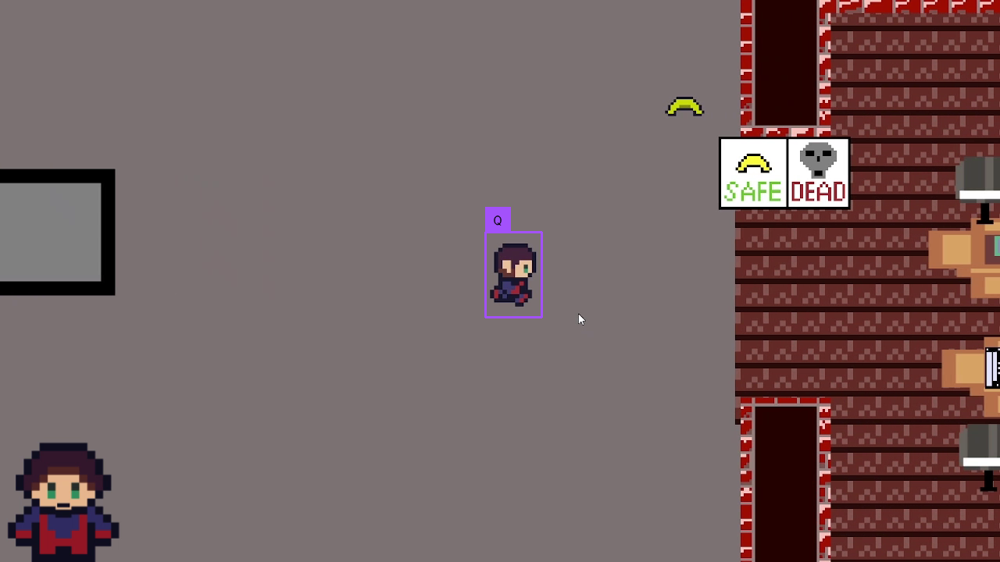

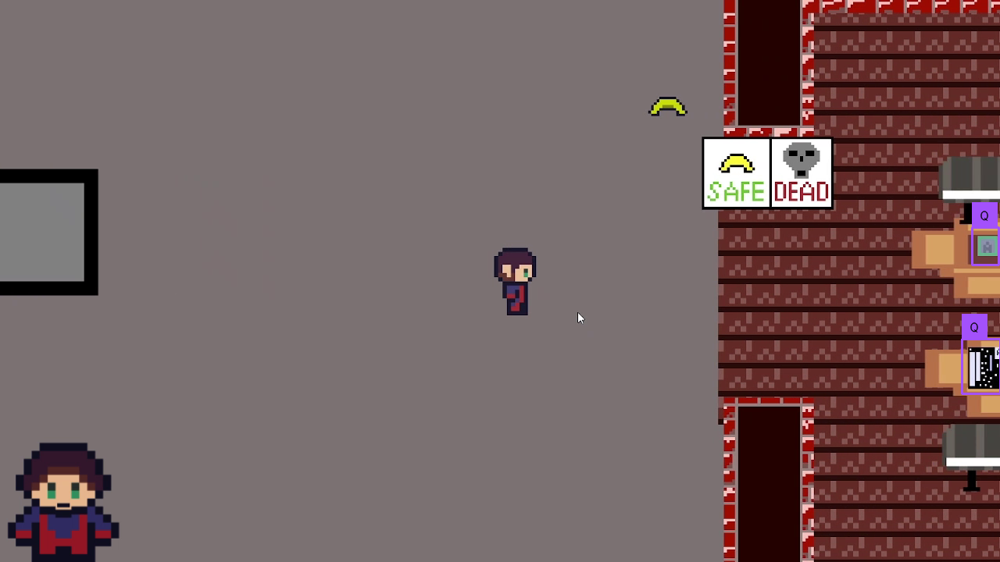

...

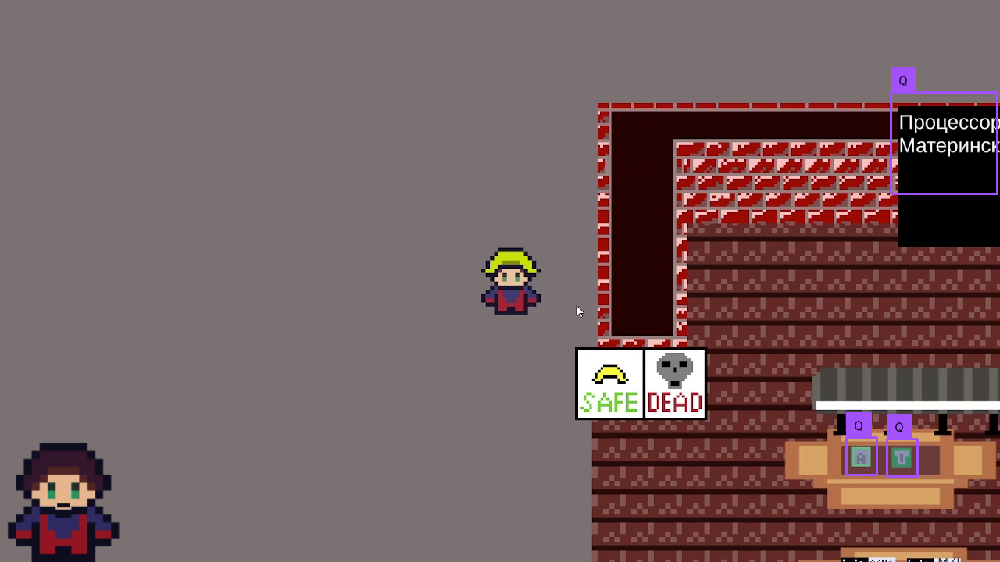

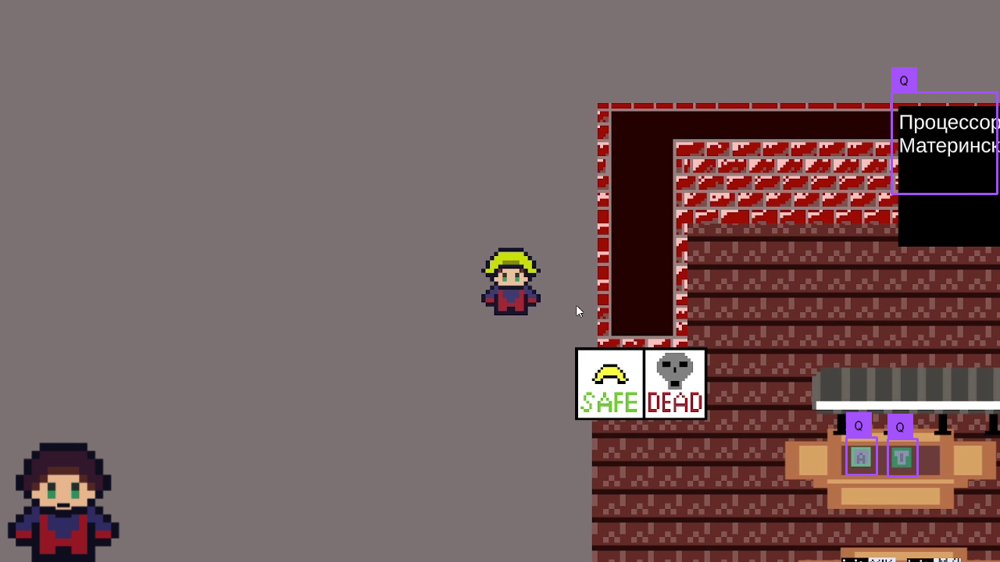

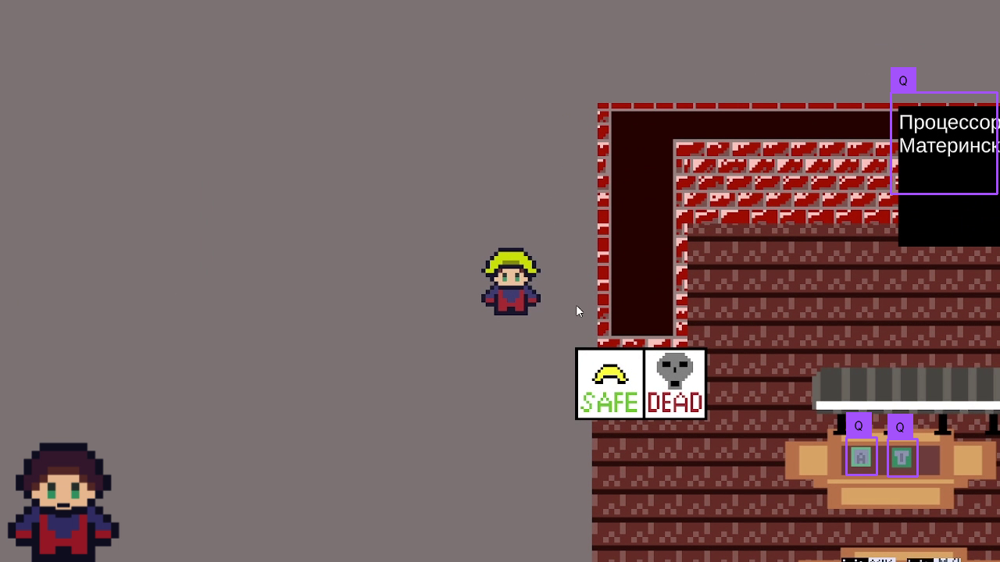

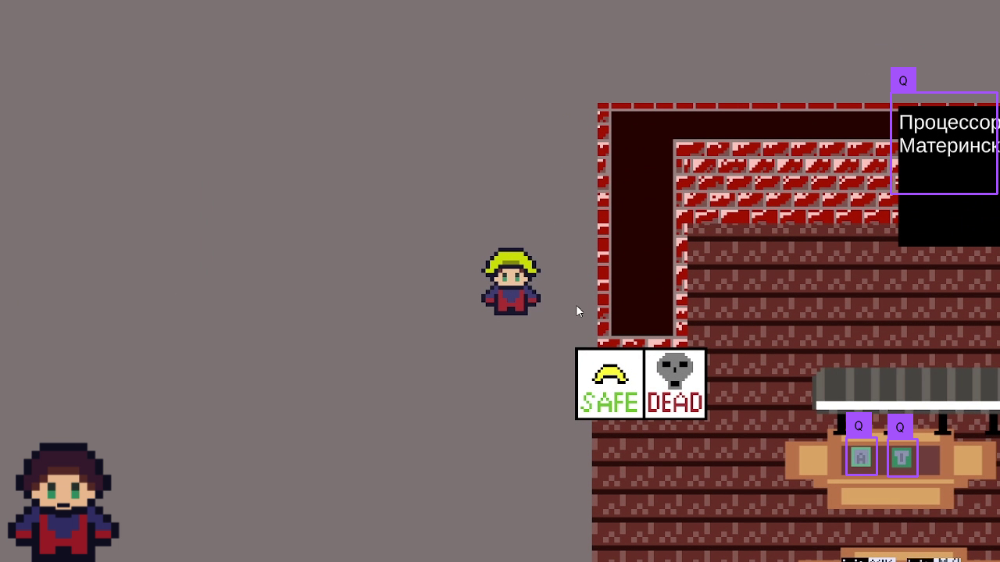

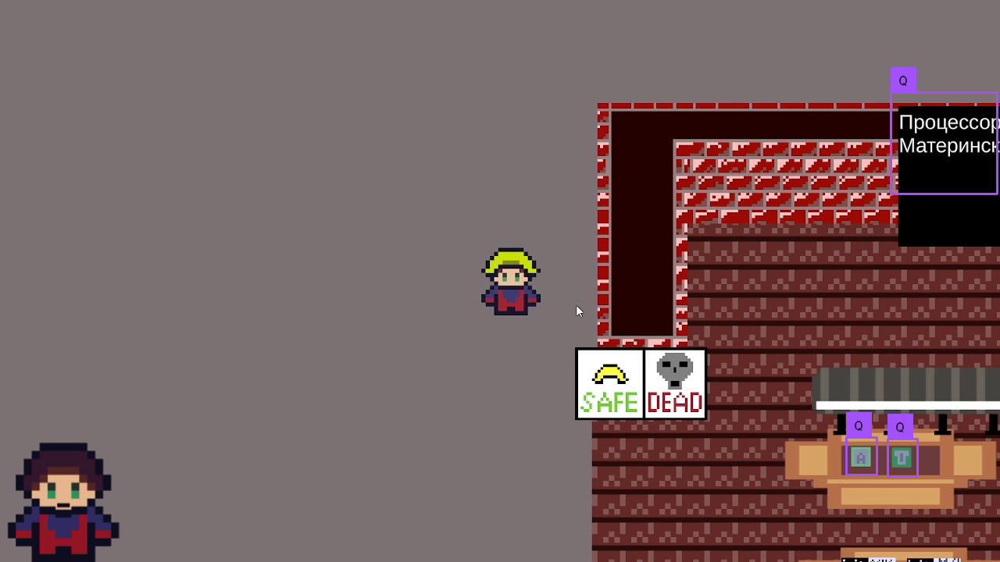

In [ ]:
import supervision as sv
import numpy as np
import roboflow
import cv2
import time
from supervision import Detections
from google.colab.patches import cv2_imshow

INPUT_VIDEO = "/content/drive/MyDrive/12.01  Python/Roboflow/ГотовоеПК.mp4"

rf = roboflow.Roboflow(api_key="6PVuFYva42GrNxS7gFqx")

project = rf.workspace("igor-gxgi4").project("qq-miegb")

model = project.version(1).model

CLASSES_TO_CHECK = ["QQ"]

CLASS_IDX = {class_name: i for i, class_name in enumerate(CLASSES_TO_CHECK)}

CLASS_ID_TO_FILTER = [CLASS_IDX[class_name] for class_name in CLASSES_TO_CHECK]

detections_buffer = []

for i, frame in enumerate(sv.get_video_frames_generator(source_path=INPUT_VIDEO)):
    if len(detections_buffer) > 240:
        detections_buffer.pop(0)

    inference_results = model.predict(frame)

    detections = sv.Detections.from_inference(inference_results.json())

    # Проверяем, присутствует ли ключ 'class_name' в detections.data
    if 'class_name' in detections.data:
        detections_filtered = [
            detection for detection, class_name in zip(detections, detections.data['class_name'])
            if class_name[0] in CLASSES_TO_CHECK
        ]

        detections_buffer.append(detections)

        box_annotator = sv.BoxAnnotator()

        labels = [
            f"{class_name[0]}" for class_name in detections.data['class_name']
        ]

        annotated_frame = box_annotator.annotate(
            scene=frame.copy(),
            detections=detections,
            labels=labels
        )

        cv2_imshow(annotated_frame)
        time.sleep(1)
    else:
        print("Ключ 'class_name' отсутствует в detections.data")


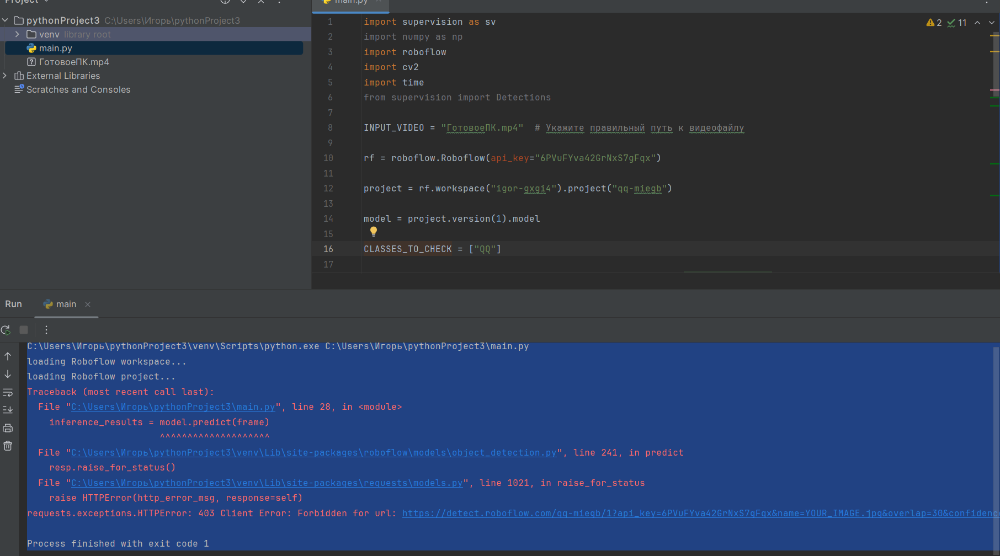

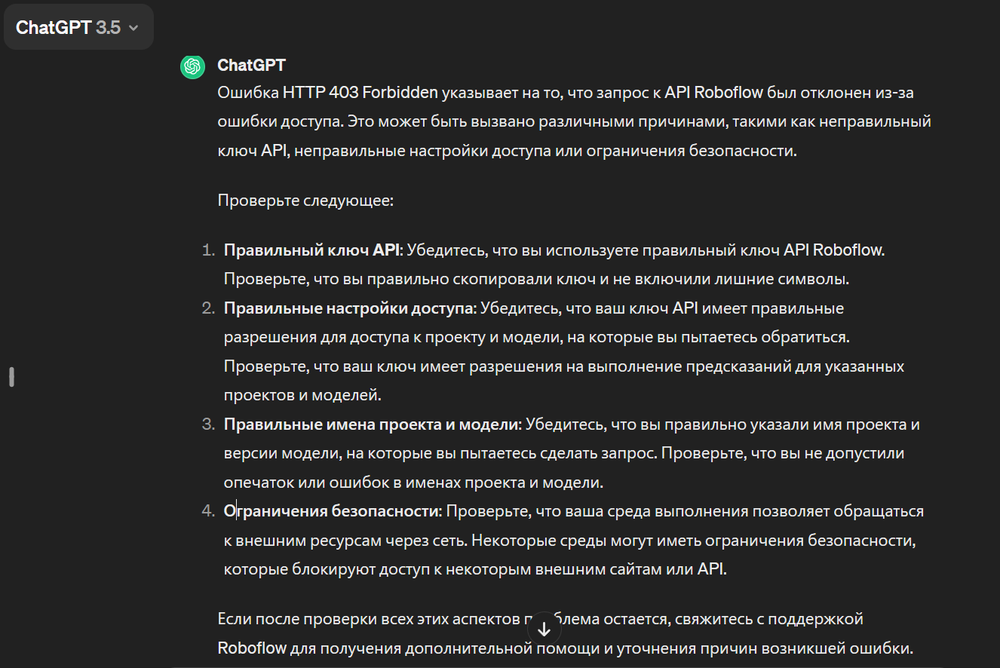